# Prepare environment
Load Python packages:

In [1]:
import warnings

warnings.filterwarnings("ignore")

import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import pandas as pd
import numpy as np
import random
import itertools

from tqdm import tqdm

import decoupler as dc
import sys

sys.path.append("./../../../../utilities_folder/")
from utilities import save_object, load_object, intTable, plotGenesInTerm, run_ora_catchErrors, getAnnGenes, filter_by_expr

Set R environment with rpy2:

In [2]:
import rpy2.rinterface_lib.callbacks
import anndata2ri
import logging

from rpy2.robjects import pandas2ri
import rpy2.robjects as ro
from scipy import stats

sc.settings.verbosity = 0
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

Set up parameters for Python plots:

In [3]:
%matplotlib inline
sc.set_figure_params(dpi = 600, fontsize = 20)

plt.rcParams['pdf.fonttype'] = 'truetype'

cmap_up = sns.light_palette("red", as_cmap=True)
cmap_down = sns.light_palette("blue", as_cmap=True)
cmap_all = sns.light_palette("seagreen", as_cmap=True)

color_palette = {
    'iMeLC': '#377eb8',
    'hEGCLC': '#ff7f00',
    'hPGCLC': '#4daf4a',
    'hiPSC': '#dd1c77',
    'HEP': '#a65628',
    'MLC': '#f781bf',
    'EndLC': '#999999',
     'AmLC': '#80b1d3',
}

Import R libraries:

In [4]:
%%R
source('./../../../../utilities_folder/GO_helper.r')
loc <- './../../../../R_loc' # pointing to the renv environment

.libPaths(loc)

library('topGO')
library('edgeR')
library('org.Hs.eg.db')
library(dplyr)
library(ggplot2)

Import some R functions directly in Python:

In [5]:
edgeR_topTags = ro.r['topTags']
edgeR_glmLRT = ro.r['glmLRT']
edgeR_glmQLFTest = ro.r['glmQLFTest']
as_data_frame = ro.r['as.data.frame']
rprint = rpy2.robjects.globalenv.find("print")

Set up some parameters for R plots:

In [6]:
#| echo: false

default_units = 'in' 
default_res = 300 
default_width = 10
default_height = 9

import rpy2
old_setup_graphics = rpy2.ipython.rmagic.RMagics.setup_graphics

def new_setup_graphics(self, args):
    if getattr(args, 'units') is not None:
        if args.units != default_units: # a different units argument was passed, do not apply defaults
            return old_setup_graphics(self, args)
    args.units = default_units
    if getattr(args, 'res') is None:
        args.res = default_res
    if getattr(args, 'width') is None:
        args.width = default_width
    if getattr(args, 'height') is None:
        args.height = default_height        
    return old_setup_graphics(self, args)

rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

## Set up folders

In [7]:
tables_folder = './tables/'

# Load data
Here we load the anndata:

In [8]:
adata = sc.read("./../01_Annotation/2_All_WithCellCycle.h5ad")
adata

AnnData object with n_obs × n_vars = 27925 × 14582
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'gene_UMI_ratio', 'log1p_gene_UMI_ratio', 'scDblFinder_score', 'scDblFinder_class', 'n_counts', 'n_genes', 'leiden', 'score_pluripotency', 'score_mesoderm', 'score_PS', 'score_EM', 'score_AM', 'score_Endo', 'score_Epi', 'score_HEP', 'score_NM', 'score_ExM', 'score_Ery', 'score_EAE', 'score_Amnion_LC', 'score_AxM', 'score_Amnion', 'score_NNE', 'score_PGC', 'score_hPGCLCs', 'score_DE1', 'score_DE2', 'score_Hypoblast', 'score_YS', 'score_EMPs', 'score_Endothelium', 'score_Myeloid_Progenitors', 'score_Megakaryocyte_

Here we load the dictionary that associates to each GO term its genes:

In [9]:
GO2gene = load_object('./../../../../data/GO2gene.pickle')

## Subset on cell types of interest
Since we are interested in a comparison between hEGCLC and hiPSC, we build the pseudobulk on the subsetted AnnData from which we filter the genes that are not expressed in more than 100 cells.

In [10]:
adata_sub = adata[adata.obs.CellTypes.isin(['hEGCLC', 'hiPSC'])].copy()
adata_sub

AnnData object with n_obs × n_vars = 14633 × 14582
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'gene_UMI_ratio', 'log1p_gene_UMI_ratio', 'scDblFinder_score', 'scDblFinder_class', 'n_counts', 'n_genes', 'leiden', 'score_pluripotency', 'score_mesoderm', 'score_PS', 'score_EM', 'score_AM', 'score_Endo', 'score_Epi', 'score_HEP', 'score_NM', 'score_ExM', 'score_Ery', 'score_EAE', 'score_Amnion_LC', 'score_AxM', 'score_Amnion', 'score_NNE', 'score_PGC', 'score_hPGCLCs', 'score_DE1', 'score_DE2', 'score_Hypoblast', 'score_YS', 'score_EMPs', 'score_Endothelium', 'score_Myeloid_Progenitors', 'score_Megakaryocyte_

In [11]:
sc.pp.filter_genes(adata_sub, min_cells = 100)
adata_sub

AnnData object with n_obs × n_vars = 14633 × 13921
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'gene_UMI_ratio', 'log1p_gene_UMI_ratio', 'scDblFinder_score', 'scDblFinder_class', 'n_counts', 'n_genes', 'leiden', 'score_pluripotency', 'score_mesoderm', 'score_PS', 'score_EM', 'score_AM', 'score_Endo', 'score_Epi', 'score_HEP', 'score_NM', 'score_ExM', 'score_Ery', 'score_EAE', 'score_Amnion_LC', 'score_AxM', 'score_Amnion', 'score_NNE', 'score_PGC', 'score_hPGCLCs', 'score_DE1', 'score_DE2', 'score_Hypoblast', 'score_YS', 'score_EMPs', 'score_Endothelium', 'score_Myeloid_Progenitors', 'score_Megakaryocyte_

# Prepare pseudobulk

In [12]:
adata_bulk = dc.get_pseudobulk(adata_sub, sample_col='sample_id', groups_col='CellTypes', layer='raw', min_prop=0, min_smpls = 2)
adata_bulk.layers['raw'] = adata_bulk.X.copy()
adata_bulk

AnnData object with n_obs × n_vars = 5 × 13921
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'scDblFinder_class', 'CellTypes'
    layers: 'raw'

# edgeR analysis
## Prepare pseudobulk count and metadata

I filter out genes based on their expression in each group, based on the function at https://decoupler-py.readthedocs.io/en/latest/generated/decoupler.filter_by_expr.html#decoupler.filter_by_expr

In [13]:
adata_bulk.obs['test'] = np.where(adata_bulk.obs.CellTypes.isin(['hiPSC', 'hEGCLC']), 1, 0) 
adata_bulk = adata_bulk[adata_bulk.obs.test == 1]

genes_to_keep = filter_by_expr(adata_bulk, group = 'CellTypes', min_count = 10, min_total_count = 20)
adata_bulk = adata_bulk[:, genes_to_keep]

sc.pp.normalize_total(adata_bulk, target_sum = 1e6)
sc.pp.log1p(adata_bulk)

obs = adata_bulk.obs
adata_bulk

AnnData object with n_obs × n_vars = 5 × 13921
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'scDblFinder_class', 'CellTypes', 'test'
    uns: 'log1p'
    layers: 'raw'

In [14]:
del adata_bulk.obs["notes"]
del adata_bulk.obs["mosaic"]
del adata_bulk.obs["total_counts_ribo"]
del adata_bulk.obs["log1p_total_counts_ribo"]
del adata_bulk.obs["pct_counts_ribo"]

In [15]:
adata_bulk.write('3_Pseudobulk_hiPSC_EG.h5ad')

In [16]:
len(genes_to_keep)

13921

In [17]:
adata_bulk.obs.CellTypes

EG2_hEGCLC          hEGCLC
EG31_hEGCLC         hEGCLC
EG9_hEGCLC          hEGCLC
IEO_13_A_R_hiPSC     hiPSC
ht15_FIX_hiPSC       hiPSC
Name: CellTypes, dtype: category
Categories (2, object): ['hEGCLC', 'hiPSC']

In [18]:
total = pd.DataFrame(adata_bulk.layers['raw'].T, columns = adata_bulk.obs_names, index = adata_bulk.var_names)

total.index = adata_bulk.var_names
total.columns = adata_bulk.obs_names
total

,EG2_hEGCLC,EG31_hEGCLC,EG9_hEGCLC,IEO_13_A_R_hiPSC,ht15_FIX_hiPSC
A2ML1,153.0,206.0,122.0,142.0,139.0
A4GALT,1347.0,1298.0,1009.0,991.0,1108.0
AAAS,5013.0,4689.0,5185.0,7215.0,9254.0
AACS,5741.0,4033.0,6260.0,5337.0,5726.0
AADACL3,175.0,128.0,205.0,35.0,16.0
...,...,...,...,...,...
ZXDC,2341.0,2347.0,2445.0,2548.0,3444.0
ZYG11A,165.0,231.0,99.0,517.0,754.0
ZYG11B,2746.0,2526.0,3095.0,2903.0,4624.0
ZYX,22777.0,16653.0,27183.0,12780.0,17644.0


In [19]:
ct_map = {'EG2':'hEGCLC', 
 'EG31':'hEGCLC', 
 'EG9':'hEGCLC', 
 'R':'hiPSC', 
 'FIX':'hiPSC'}

In [20]:
celltypes = total.columns.map(lambda x: x.split('_')[-1])
celltypes

Index(['hEGCLC', 'hEGCLC', 'hEGCLC', 'hiPSC', 'hiPSC'], dtype='object')

In [21]:
obs['CellTypes'] = obs['CellTypes'].astype('str')

In [22]:
for col in obs.columns:
    if obs[col].dtype == 'object':
        obs[col] = obs[col].astype('str')

## Correlation between celltypes expression

In [23]:
sns.heatmap(total.corr(method = 'spearman'), vmin = 0, vmax = 1)

<AxesSubplot:>

## Set up model matrix

In [24]:
%%R -i celltypes -i total

celltypes <- relevel(as.factor(celltypes), ref="hiPSC")
print(celltypes)
print(total[0:10, ])

mm <- model.matrix(~ celltypes, data = total)
colnames(mm)

[1] hEGCLC hEGCLC hEGCLC hiPSC  hiPSC 
Levels: hiPSC hEGCLC
        EG2_hEGCLC EG31_hEGCLC EG9_hEGCLC IEO_13_A_R_hiPSC ht15_FIX_hiPSC
A2ML1          153         206        122              142            139
A4GALT        1347        1298       1009              991           1108
AAAS          5013        4689       5185             7215           9254
AACS          5741        4033       6260             5337           5726
AADACL3        175         128        205               35             16
AADAT          772         563        847              767           1127
AAGAB         6122        4680       6805             5934           7537
AAK1          2643        2105       3045             1678           2407
AAMDC         3207        3509       2640             3747           4253
AAMP         17708       14792      17470            14798          22379
[1] "(Intercept)"     "celltypeshEGCLC"


In [25]:
%%R

ncol(mm)

[1] 2


## Run glm
### Normalize counts

In [26]:
%%R -i total -o dds

row.names(mm) <- colnames(total)
dds <- calcNormFactors(DGEList(total))
dds <- estimateDisp(dds, mm)
dds <- glmFit(dds, mm)

In [27]:
%%R
names(dds)

 [1] "coefficients"          "fitted.values"         "deviance"             
 [4] "method"                "counts"                "unshrunk.coefficients"
 [7] "df.residual"           "design"                "offset"               
[10] "dispersion"            "prior.count"           "samples"              
[13] "prior.df"              "AveLogCPM"            


In [28]:
n_covariates = 2

In [29]:
%%R -o covar_names

covar_names <- colnames(mm)

## Get results

In [30]:
table_list = []

for i in range(n_covariates):
    
    deg_table = edgeR_topTags(edgeR_glmLRT(dds, coef=i+1), len(total))
    deg_table = as_data_frame(deg_table)
    #deg_table = rpy2.robjects.pandas2ri.rpy2py(deg_table)
    table_list.append(deg_table)
    
    n_significant = len(deg_table[(deg_table.FDR < 0.01)])
    print(covar_names[i], n_significant)

(Intercept) 13921
celltypeshEGCLC 890


Formatting of the table containing all the degs:
* I add a column called "Gene" that is useful to downstream functions for plotting
* I fill all the FDR == 0 with the closest FDR (smaller FDR that is different from zero) so I still maintain a high significance of the gene but I don't get error when computing the log10(FDR) and also the plotting is nicer

In [31]:
deg_table['Gene'] = deg_table.index
deg_table['FDR'] = deg_table['FDR'].replace(0.0, deg_table['FDR'][deg_table['FDR'] != 0.0].min())
deg_table['-log10(FDR)'] = -np.log10(deg_table.FDR)

# Save DEGs unfiltered

In [32]:
intTable(deg_table, folder = tables_folder, fileName = 'Bulk_hEGCLCs_vs_hiPSC_total.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/Bulk_hEGCLCs_vs_..., filename='Bulk_hEGCLCs_vs_hiPSC_tot..., label='Download Bulk_hEGCLCs_vs_...)
    [1] Tabulator(page_size=10, pagination='remote', value=             l...)

In [33]:
allGenes = deg_table.index.tolist()
AllFDRScores = deg_table.FDR.tolist()

## Filter results by logFC and LR
Genes are filtered according to:
* FDR < 0.01
* absolute logFC > 2 (logFC < -2 or logFC > 2)

In [34]:
deg_table_filtered = deg_table[deg_table['FDR'] < 0.01]
deg_table_filtered = deg_table_filtered[np.abs(deg_table_filtered['logFC']) > 2]
len(deg_table_filtered)

116

In [35]:
#sns.color_palette(adata_bulk.uns['CellTypes_colors'])

adata_bulk.uns['CellTypes_colors'] = []
adata_bulk.uns['CellTypes_colors'].append(color_palette['hEGCLC'])
adata_bulk.uns['CellTypes_colors'].append(color_palette['hiPSC'])

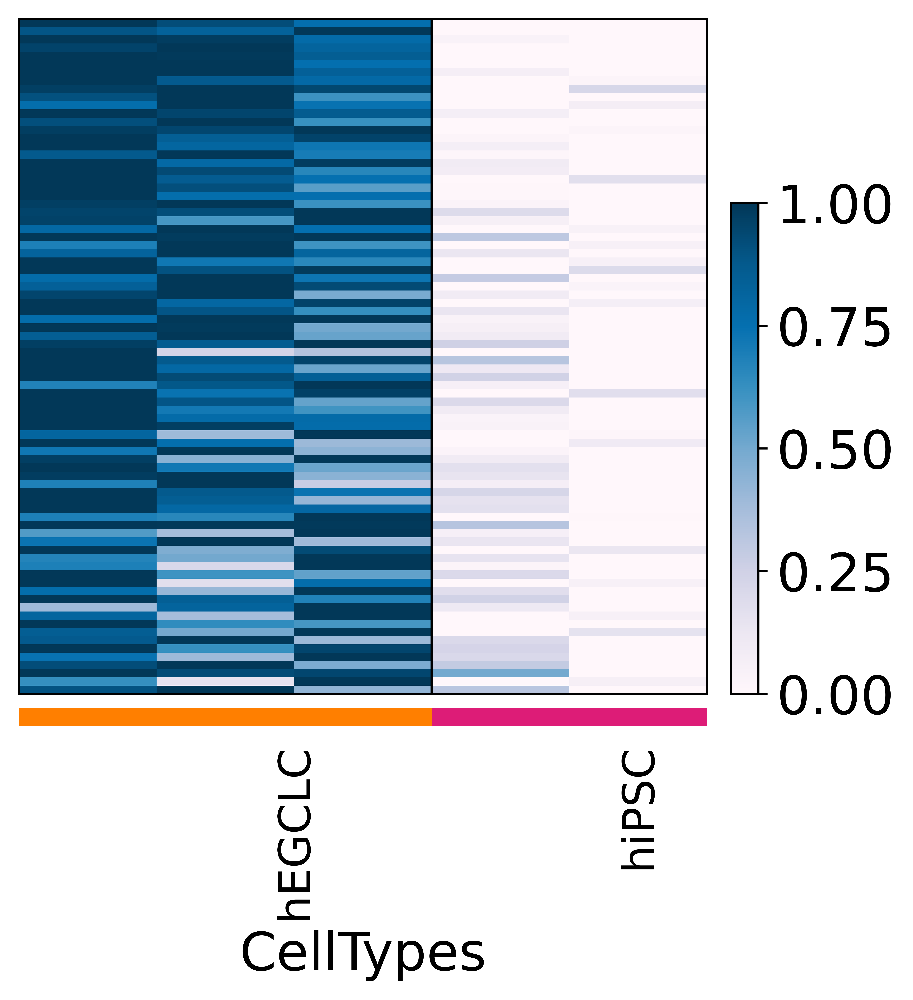

In [36]:
sc.pl.heatmap(adata_bulk, 
              var_names = deg_table_filtered[deg_table_filtered.logFC > 0].index,
              groupby = 'CellTypes', 
              cmap = 'PuBu', 
              swap_axes = True, 
              figsize = (5,5), standard_scale = 'var', save='_DEGs_up_hEGCL.pdf')

In [37]:
sc.pl.heatmap(adata_bulk, 
              var_names = deg_table_filtered[deg_table_filtered.logFC < -2].index,
              groupby = 'CellTypes', 
              cmap = 'PuBu', 
              swap_axes = True, 
              figsize = (5,10), standard_scale = 'var', save='_DEGs_up_hiPSC_vs_hEGCL.pdf')

### Select up and downregulated DEGs
#### Upregulated in hEGCLC

In [38]:
up_reg = deg_table_filtered[deg_table_filtered.logFC > 2]
up_regGenes = up_reg.index.tolist()

In [39]:
print(f'The number of upregulated genes is {len(up_regGenes)}')

The number of upregulated genes is 82


In [40]:
allUpSelected = deg_table.index.isin(up_regGenes).astype('int').tolist()

In [41]:
intTable(up_reg, folder = tables_folder, fileName = 'Bulk_hEGCLCs_vs_hiPSC_upregulated.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/Bulk_hEGCLCs_vs_..., filename='Bulk_hEGCLCs_vs_hiPSC_upr..., label='Download Bulk_hEGCLCs_vs_...)
    [1] Tabulator(page_size=10, pagination='remote', value=            logFC  ...)

#### Downregulated in EGCLC (= up in iPSC)

In [42]:
down_reg = deg_table_filtered[deg_table_filtered.logFC < 0]
down_regGenes = down_reg.index.tolist()

In [43]:
print(f'The number of downregulated genes is {len(down_regGenes)}')

The number of downregulated genes is 34


In [44]:
intTable(down_reg, folder = tables_folder, fileName = 'Bulk_hEGCLCs_vs_hiPSC_downregulated.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/Bulk_hEGCLCs_vs_..., filename='Bulk_hEGCLCs_vs_hiPSC_dow..., label='Download Bulk_hEGCLCs_vs_...)
    [1] Tabulator(page_size=10, pagination='remote', value=            logFC  ...)

In [45]:
allDownSelected = deg_table.index.isin(down_regGenes).astype('int').tolist()

#### All modulated genes

In [46]:
all_sign = up_regGenes + down_regGenes
allSelected = deg_table.index.isin(all_sign).astype('int').tolist()

In [47]:
print(f'The total number of modulated genes is {len(all_sign)}')

The total number of modulated genes is 116


In [48]:
intTable(deg_table_filtered, folder = tables_folder, fileName = 'Bulk_hEGCLCs_vs_hiPSC_filtered.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/Bulk_hEGCLCs_vs_..., filename='Bulk_hEGCLCs_vs_hiPSC_fil..., label='Download Bulk_hEGCLCs_vs_...)
    [1] Tabulator(page_size=10, pagination='remote', value=            logFC  ...)

# Heatmaps if DEGs
## Upregulated in hEGCLCs - Downregulated in hiPSC
### Single cell data

In [49]:
df_ordered = pd.DataFrame(adata_bulk[:,up_regGenes].X[[0, 1, 2]]).T
df_ordered.index = adata_bulk[:,up_regGenes].var_names
df_ordered['Median'] = df_ordered.median(axis = 1)
df_ordered= df_ordered.sort_values(by = 'Median')

Scaled by `obs` -> for each observation (in each column), each value have the minimum of the column subtracted, then the value is divided by the maximum of the column -> to compare the expression of the genes **within** a condition

In [50]:
sc.pl.heatmap(adata[adata.obs.CellTypes.isin(['hiPSC', 'hEGCLC'])], var_names = df_ordered.index, 
              groupby = 'CellTypes', cmap = 'PuBu', swap_axes = True, figsize = (10,10), 
               standard_scale='obs')

Scaled by `var` -> for each gene (in each row), each value have the minimum of the row subtracted, then the value is divided by the maximum of the row -> to compare the expression of the genes **across** conditions

In [51]:
sc.pl.heatmap(adata[adata.obs.CellTypes.isin(['hiPSC', 'hEGCLC'])], var_names = df_ordered.index, 
              groupby = 'CellTypes', cmap = 'PuBu', swap_axes = True, figsize = (10,10), 
               standard_scale='var')

### Pseudobulk

Scaled by `obs` -> for each observation (in each column), each value have the minimum of the column subtracted, then the value is divided by the maximum of the column -> to compare the expression of the genes **within** a condition

In [52]:
sc.pl.heatmap(adata_bulk, 
              var_names = df_ordered.index,
              groupby = 'CellTypes', 
              cmap = 'PuBu', 
              swap_axes = True, 
              figsize = (5,10), standard_scale = 'obs')

Scaled by `var` -> for each gene (in each row), each value have the minimum of the row subtracted, then the value is divided by the maximum of the row -> to compare the expression of the genes **across** conditions

In [53]:
sc.pl.heatmap(adata_bulk, 
              var_names = df_ordered.index,
              groupby = 'CellTypes', 
              cmap = 'PuBu', 
              swap_axes = True, 
              figsize = (5,10), standard_scale = 'var')

## Downregulated in hEGCLCs - Upregulated in hiPSC

In [54]:
df_ordered = pd.DataFrame(adata_bulk[:,down_regGenes].X[[0, 1, 2]]).T
df_ordered.index = adata_bulk[:,down_regGenes].var_names
df_ordered['Median'] = df_ordered.median(axis = 1)
df_ordered= df_ordered.sort_values(by = 'Median')

#### Single cell data

Scaled by `obs` -> for each observation (in each column), each value have the minimum of the column subtracted, then the value is divided by the maximum of the column -> to compare the expression of the genes **within** a condition

In [55]:
sc.pl.heatmap(adata[adata.obs.CellTypes.isin(['hiPSC', 'hEGCLC'])], var_names = df_ordered.index, 
              groupby = 'CellTypes', cmap = 'PuBu', swap_axes = True, figsize = (10,10), 
               standard_scale='obs')

Scaled by `var` -> for each gene (in each row), each value have the minimum of the row subtracted, then the value is divided by the maximum of the row -> to compare the expression of the genes **across** conditions

In [56]:
sc.pl.heatmap(adata[adata.obs.CellTypes.isin(['hiPSC', 'hEGCLC'])], var_names = df_ordered.index, 
              groupby = 'CellTypes', cmap = 'PuBu', swap_axes = True, figsize = (10,10), 
               standard_scale='var')

### Pseudobulk

Scaled by `obs` -> for each observation (in each column), each value have the minimum of the column subtracted, then the value is divided by the maximum of the column -> to compare the expression of the genes **within** a condition

In [57]:
sc.pl.heatmap(adata_bulk, 
              var_names = df_ordered.index,
              groupby = 'CellTypes', 
              cmap = 'PuBu', 
              swap_axes = True, 
              figsize = (5,10), standard_scale = 'obs')

Scaled by `var` -> for each gene (in each row), each value have the minimum of the row subtracted, then the value is divided by the maximum of the row -> to compare the expression of the genes **across** conditions

In [58]:
sc.pl.heatmap(adata_bulk, 
              var_names = df_ordered.index,
              groupby = 'CellTypes', 
              cmap = 'PuBu', 
              swap_axes = True, 
              figsize = (5,10), standard_scale = 'var')

# topGO

In [59]:
print(f'The number of all filtered DEGs in hEGCLC vs hiPSC is {len(deg_table_filtered)}')
print(f'The number of upregulated genes in hEGCLC vs hiPSC is {len(up_regGenes)}')
print(f'The number of downregulated genes in hEGCLC vs hiPSC is {len(down_regGenes)}')

The number of all filtered DEGs in hEGCLC vs hiPSC is 116
The number of upregulated genes in hEGCLC vs hiPSC is 82
The number of downregulated genes in hEGCLC vs hiPSC is 34


## hEGCLC upregulated

### Get annotations for upreg genes

In [60]:
%%R -i allUpSelected -i allGenes -i up_regGenes


#allGenes_v <- c(allUpSelected)
allGenes_v <- factor(as.integer(allGenes %in% up_regGenes))
#print(allGenes_v)
names(allGenes_v) <- allGenes
allGenes_v <- unlist(allGenes_v)


geneNames <- c(allGenes)

ann_org_BP <- topGO::annFUN.org(whichOnto='BP', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_MF <- topGO::annFUN.org(whichOnto='MF', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_CC <- topGO::annFUN.org(whichOnto='CC', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')


selection <- function(allScores){return (as.logical(allScores))}


params <- list(GoEnTh = 2, GoPvalTh = 0.01)

In [61]:
len(up_regGenes)

82

In [62]:
up_regGenes[0:10]

['ZNF560',
 'TAF9B',
 'ZNF662',
 'CRISP2',
 'NKAPL',
 'PTPN20',
 'CRYAB',
 'HSPB2',
 'CTSF',
 'CYP4F22']

In [63]:
%%R
print(allGenes_v[0:10])

  ZNF560    TAF9B   ZNF662   CRISP2   TWIST2    NKAPL   PTPN20 HIST1H1D 
       1        1        1        1        0        1        1        0 
   CRYAB    HSPB2 
       1        1 
Levels: 0 1


::: {.panel-tabset}

### Biological Process

In [64]:
%%R -o ResBPAll -o ResSel
ResBPAll <- topGOResults_new(Genes=allGenes_v, GO2genes=ann_org_BP, ontology='BP', 
                         desc=NULL, nodeSize=15, algorithm='weight01', statistic='fisher', 
                         EnTh=params$GoEnTh, PvalTh=params$GoPvalTh, minTerms=15, geneTh=4,
                         saveRes=FALSE, maxAnn = 500)

ResSel <- ResBPAll$ResSel

In [65]:
%%R

ResBPAll$GOdata


------------------------- topGOdata object -------------------------

 Description:
   -  BP allGenes_v 

 Ontology:
   -  BP 

 13921 available genes (all genes from the array):
   - symbol:  ZNF560 TAF9B ZNF662 CRISP2 TWIST2  ...
   - 82  significant genes. 

 12478 feasible genes (genes that can be used in the analysis):
   - symbol:  ZNF560 TAF9B ZNF662 TWIST2 NKAPL  ...
   - 71  significant genes. 

 GO graph (nodes with at least  15  genes):
   - a graph with directed edges
   - number of nodes = 4938 
   - number of edges = 10661 

------------------------- topGOdata object -------------------------



In [66]:
len(up_regGenes)

82

In [67]:
up_regGenes[0:10]

['ZNF560',
 'TAF9B',
 'ZNF662',
 'CRISP2',
 'NKAPL',
 'PTPN20',
 'CRYAB',
 'HSPB2',
 'CTSF',
 'CYP4F22']

In [68]:
%%R
print(allGenes_v[0:10])

  ZNF560    TAF9B   ZNF662   CRISP2   TWIST2    NKAPL   PTPN20 HIST1H1D 
       1        1        1        1        0        1        1        0 
   CRYAB    HSPB2 
       1        1 
Levels: 0 1


In [69]:
results_table_py = ro.conversion.rpy2py(ResSel)
results_table_py['Statistics'] = results_table_py['Statistics'].astype('float64')
len(results_table_py)

15

In [70]:
results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Statistics)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [71]:
intTable(results_table_py, folder = tables_folder, fileName = 'GO_upregulated_hEGCLCs_vs_hiPSC_BP.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_upregulated_h..., filename='GO_upregulated_hEGCLCs_vs..., label='Download GO_upregulated_h...)
    [1] Tabulator(page_size=10, pagination='remote', value=         GO.ID  ...)

In [72]:
#| echo: False

default_width = 8
default_height = 4
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

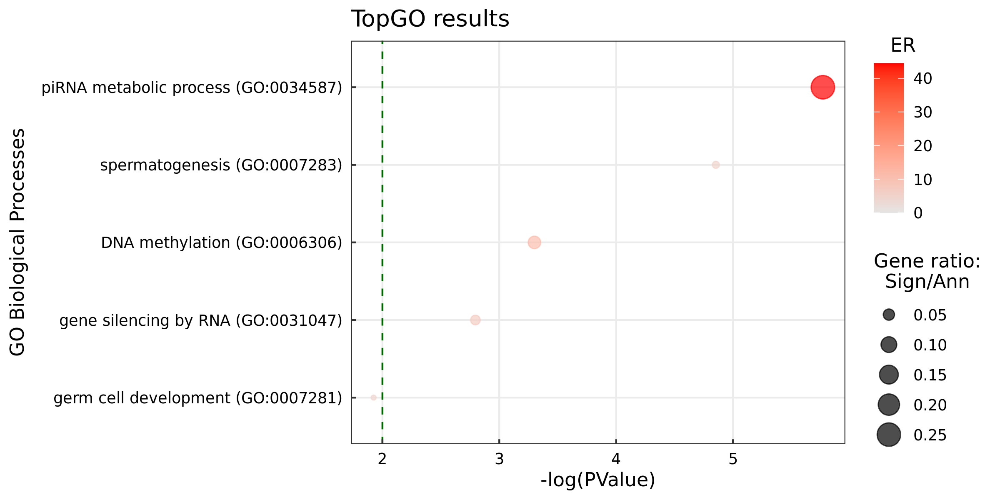

In [73]:
%%R
image = bubbleplot(ResSel, Ont = 'BP', fillCol = 'red', terms = 5)
ggsave(file="./figures/GO_BP_up_hEGCLC_vs_hiPSC.pdf", plot=image, width=8, height=4)

bubbleplot(ResSel, Ont = 'BP', fillCol = 'red', terms = 5)

In [74]:
#| echo: False

default_width = 12
default_height = 4
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

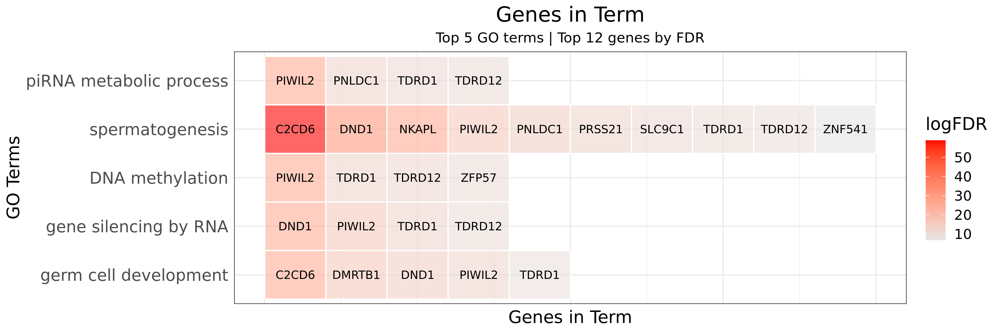

In [75]:
%%R -i deg_table_filtered

image = plotGenesInTerm_v3(ResBPAll$ResSel, ResBPAll$GOdata, DEGs = deg_table_filtered, nterms=15, ngenes=12,
                            fillCol='red')
ggsave(file="./figures/Genes_in_term_BP_up_hEGCLC_vs_hiPSC.pdf", plot=image, width=12, height=4)

plotGenesInTerm_v3(ResBPAll$ResSel, ResBPAll$GOdata, DEGs = deg_table_filtered, nterms=5, ngenes=12,
                             fillCol='red')

In [76]:
%%R -i tables_folder
saveGenesInTerm(ResBPAll$ResSel, ResBPAll$GOdata, nterms = 20, 
                path = './tables/genesInTerm_hiPSC_hEGCLCs_GO_BP_uphEGCLC.csv', 
                )

In [77]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Molecular Function

In [78]:
%%R -o ResMFAll -o ResSel
ResMFAll <- topGOResults_new(Genes=allGenes_v, GO2genes=ann_org_MF, ontology='MF', 
                         desc=NULL, nodeSize=15, algorithm='weight01', statistic='fisher', 
                         EnTh=params$GoEnTh, PvalTh=params$GoPvalTh, minTerms=15, geneTh=4,
                         saveRes=FALSE, outDir=paste0(OutputFolder), fileName='MFAll', maxAnn = 500)

ResSel <- ResMFAll$ResSel

In [79]:
results_table_py = ro.conversion.rpy2py(ResSel)
results_table_py['Statistics'] = results_table_py['Statistics'].astype('float64')
len(results_table_py)

9

In [80]:
results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Statistics)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [81]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_upregulated_hEGCLCs_vs_hiPSC_MF.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_upregulated_h..., filename='GO_upregulated_hEGCLCs_vs..., label='Download GO_upregulated_h...)
    [1] Tabulator(page_size=10, pagination='remote', value=        GO.ID  ...)

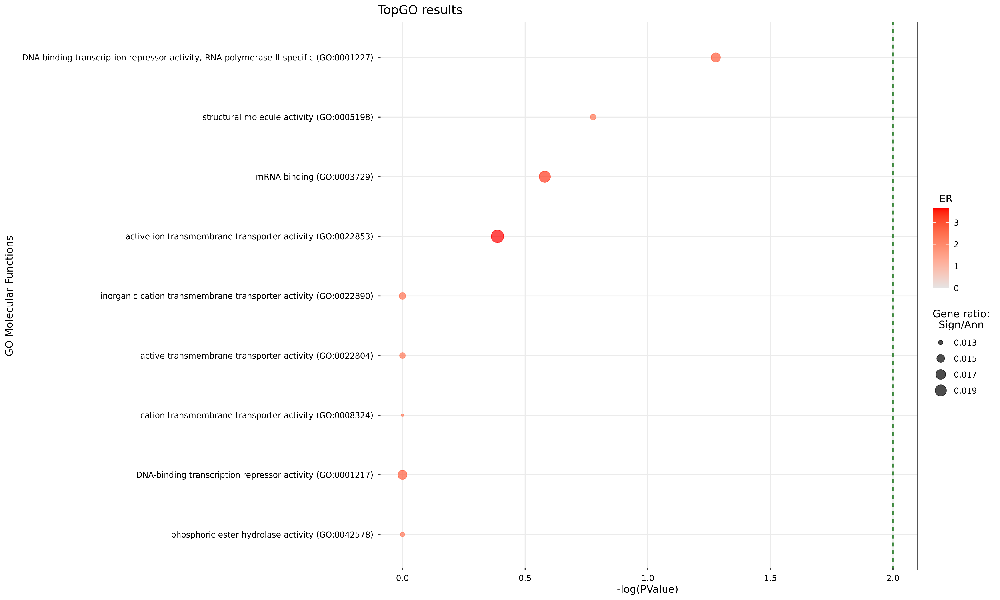

In [82]:
%%R
bubbleplot(ResSel, Ont = 'MF', fillCol = 'red')

In [83]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

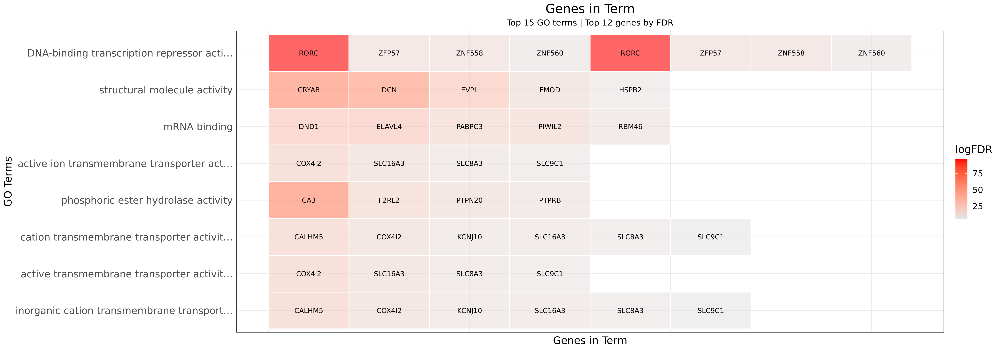

In [84]:
%%R -i deg_table_filtered
plotGenesInTerm_v3(ResMFAll$ResSel, ResMFAll$GOdata, DEGs = deg_table_filtered, nterms=15, ngenes=12,
                             fillCol='red')

In [85]:
%%R
saveGenesInTerm(ResMFAll$ResSel, ResMFAll$GOdata, nterms = 20, 
                path = './tables/genesInTerm_hiPSC_hEGCLCs_GO_MF_uphEGCLC.csv')

In [86]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Cellular Components

In [87]:
%%R -o ResCCAll -o ResSel
ResCCAll <- topGOResults_new(Genes=allGenes_v, GO2genes=ann_org_CC, ontology='CC', 
                         desc=NULL, nodeSize=15, algorithm='weight01', statistic='fisher', 
                         EnTh=params$GoEnTh, PvalTh=params$GoPvalTh, minTerms=15, geneTh=4,
                         saveRes=FALSE, outDir=paste0(OutputFolder), fileName='CCAll', maxAnn = 500)

ResSel <- ResCCAll$ResSel

In [88]:
results_table_py = ro.conversion.rpy2py(ResSel)
results_table_py['Statistics'] = results_table_py['Statistics'].astype('float64')
len(results_table_py)

6

In [89]:
results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Statistics)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [90]:
intTable(results_table_py, folder = tables_folder, fileName = 'GO_upregulated_hEGCLCs_vs_hiPSC_CC.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_upregulated_h..., filename='GO_upregulated_hEGCLCs_vs..., label='Download GO_upregulated_h...)
    [1] Tabulator(page_size=10, pagination='remote', value=        GO.ID  ...)

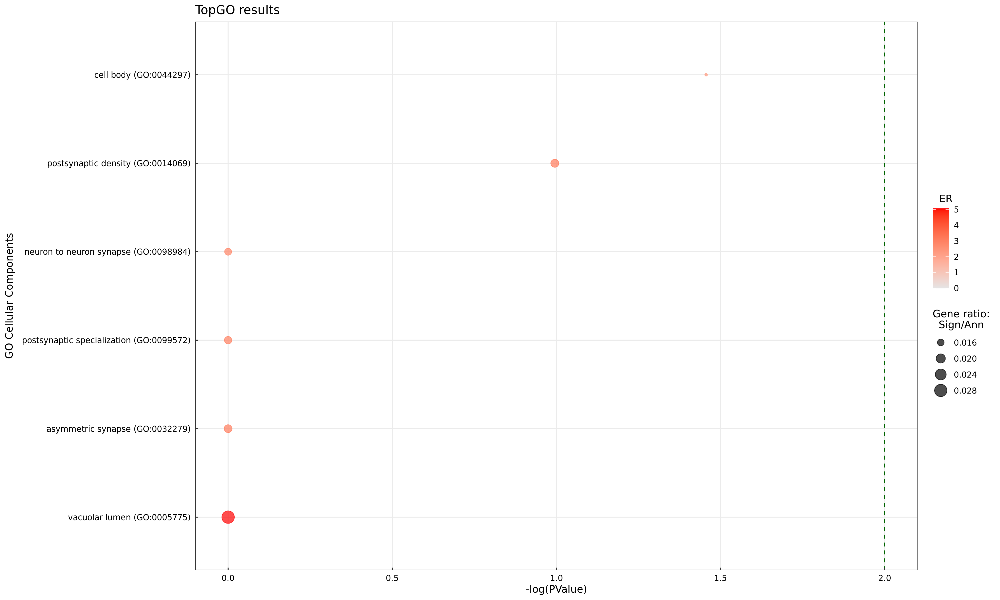

In [91]:
%%R
bubbleplot(ResSel, Ont = 'CC', fillCol = 'red')

In [92]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

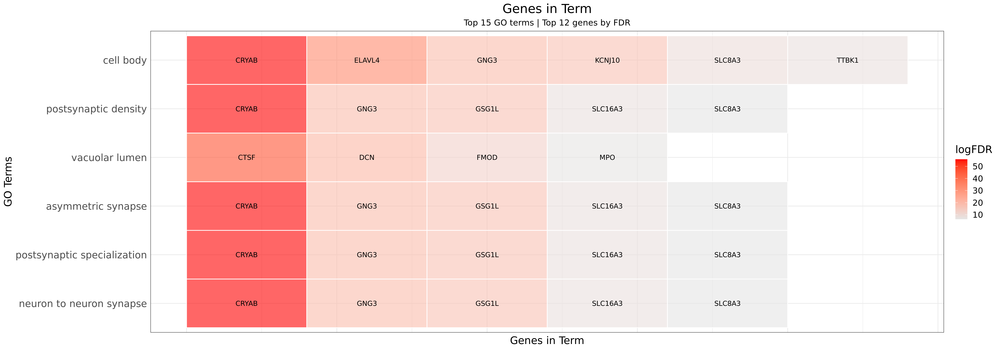

In [93]:
%%R -i deg_table_filtered
plotGenesInTerm_v3(ResCCAll$ResSel, ResCCAll$GOdata, DEGs = deg_table_filtered, nterms=15, ngenes=12,
                             fillCol='red')

In [94]:
%%R
saveGenesInTerm(ResCCAll$ResSel, ResCCAll$GOdata, nterms = 20, path = './tables/genesInTerm_hiPSC_hEGCLCs_GO_CC_uphEGCLC.csv')

In [95]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Pathway annotation

In [96]:
msigdb = dc.get_resource('MSigDB')
msigdb

,genesymbol,collection,geneset
0,MAFF,chemical_and_genetic_perturbations,BOYAULT_LIVER_CANCER_SUBCLASS_G56_DN
1,MAFF,chemical_and_genetic_perturbations,ELVIDGE_HYPOXIA_UP
2,MAFF,chemical_and_genetic_perturbations,NUYTTEN_NIPP1_TARGETS_DN
3,MAFF,immunesigdb,GSE17721_POLYIC_VS_GARDIQUIMOD_4H_BMDC_DN
4,MAFF,chemical_and_genetic_perturbations,SCHAEFFER_PROSTATE_DEVELOPMENT_12HR_UP
...,...,...,...
3838543,PRAMEF22,go_biological_process,GOBP_POSITIVE_REGULATION_OF_CELL_POPULATION_PR...
3838544,PRAMEF22,go_biological_process,GOBP_APOPTOTIC_PROCESS
3838545,PRAMEF22,go_biological_process,GOBP_REGULATION_OF_CELL_DEATH
3838546,PRAMEF22,go_biological_process,GOBP_NEGATIVE_REGULATION_OF_DEVELOPMENTAL_PROCESS


#### Reactome

In [97]:
curated = msigdb[msigdb['collection'].isin(['reactome_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 500].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [98]:
rank = pd.DataFrame(deg_table_filtered.logFC)
rank = rank[rank.logFC > 2]

rank_copy = rank.copy()
rank_copy['pval'] = deg_table_filtered.loc[rank.index].FDR

In [99]:
rank_copy

,logFC,pval
ZNF560,12.498048,1.275713e-42
TAF9B,5.954427,9.861447e-31
ZNF662,6.313032,1.226581e-29
CRISP2,10.095322,1.798185e-27
NKAPL,9.875911,2.885773e-26
...,...,...
CALHM5,2.473018,5.583475e-03
SCARA5,2.112675,7.137824e-03
MYOF,2.052413,7.162281e-03
TM4SF1,2.879223,8.117776e-03


In [100]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)

No significant term was found


In [101]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_up_hEGCLCs_vs_hiPSC_reactome.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_up_hEGCLCs_vs..., filename='GO_up_hEGCLCs_vs_hiPSC_re..., label='Download GO_up_hEGCLCs_vs...)
    [1] Tabulator(page_size=10, pagination='remote', value=Empty DataFrame
Columns: [...)

#### KEGG

In [102]:
curated = msigdb[msigdb['collection'].isin(['kegg_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 500].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [103]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)

No significant term was found


In [104]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_up_hEGCLCs_vs_hiPSC_kegg.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_up_hEGCLCs_vs..., filename='GO_up_hEGCLCs_vs_hiPSC_ke..., label='Download GO_up_hEGCLCs_vs...)
    [1] Tabulator(page_size=10, pagination='remote', value=Empty DataFrame
Columns: [...)

#### Wikipathway

In [105]:
curated = msigdb[msigdb['collection'].isin(['wikipathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 500].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [106]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)

No significant term was found


In [107]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_up_hEGCLCs_vs_hiPSC_wikipathways.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_up_hEGCLCs_vs..., filename='GO_up_hEGCLCs_vs_hiPSC_wi..., label='Download GO_up_hEGCLCs_vs...)
    [1] Tabulator(page_size=10, pagination='remote', value=Empty DataFrame
Columns: [...)

:::

## hEGCLCs downregulated
### Get annotations for downreg genes

In [108]:
%%R -i allDownSelected -i allGenes

allGenes_v <- c(allDownSelected)
#print(allGenes_v)
names(allGenes_v) <- allGenes
allGenes_v <- unlist(allGenes_v)
allGenes_v <- as.factor(allGenes_v)


geneNames <- c(allGenes)

ann_org_BP <- topGO::annFUN.org(whichOnto='BP', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_MF <- topGO::annFUN.org(whichOnto='MF', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_CC <- topGO::annFUN.org(whichOnto='CC', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

::: {.panel-tabset}

### Biological Process

In [109]:
%%R -o ResBPAll -o ResSel
ResBPAll <- topGOResults_new(Genes=allGenes_v, GO2genes=ann_org_BP, ontology='BP', 
                         desc=NULL, nodeSize=15, algorithm='weight01', statistic='fisher', 
                         EnTh=params$GoEnTh, PvalTh=params$GoPvalTh, minTerms=15, geneTh=4,
                         saveRes=FALSE, outDir=paste0(OutputFolder), fileName='BPAll', maxAnn = 500)

ResSel <- ResBPAll$ResSel

In [110]:
results_table_py = ro.conversion.rpy2py(ResSel)
results_table_py['Statistics'] = results_table_py['Statistics'].astype('float64')
len(results_table_py)

15

In [111]:
results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Statistics)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [112]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_downregulated_hEGCLCs_vs_hiPSC_BP.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_downregulated..., filename='GO_downregulated_hEGCLCs_..., label='Download GO_downregulated...)
    [1] Tabulator(page_size=10, pagination='remote', value=         GO.ID  ...)

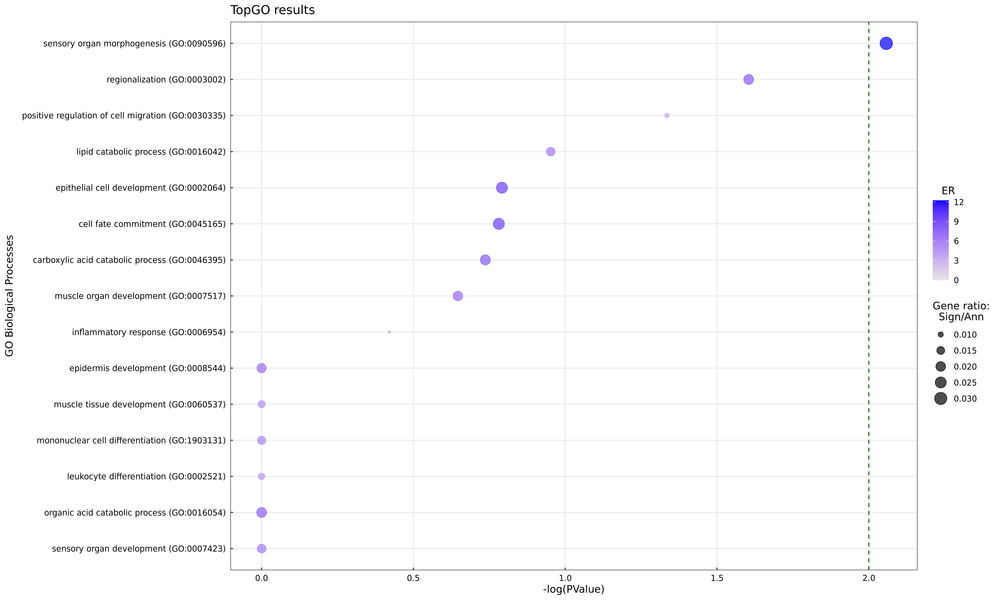

In [113]:
%%R
bubbleplot(ResSel, Ont = 'BP', fillCol = 'blue')

In [114]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

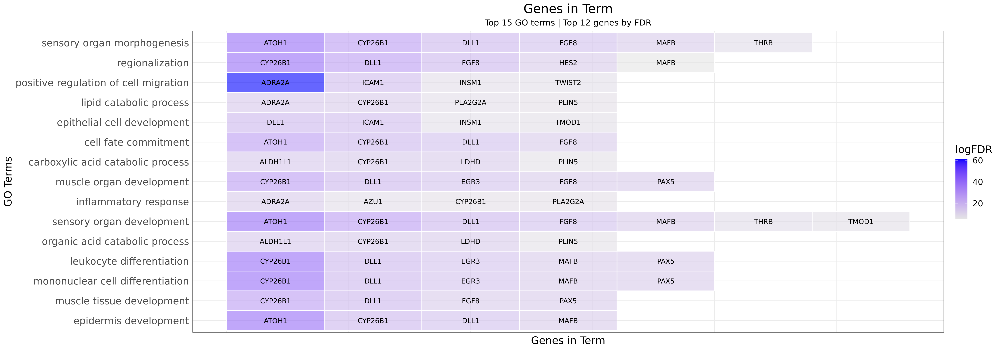

In [115]:
%%R -i deg_table_filtered
plotGenesInTerm_v3(ResBPAll$ResSel, ResBPAll$GOdata, DEGs = deg_table_filtered, nterms=15, ngenes=12,
                             fillCol='blue')

In [116]:
%%R
saveGenesInTerm(ResBPAll$ResSel, ResBPAll$GOdata, nterms = 20, path = './tables/genesInTerm_iPSC_hEGCLCs_GO_BP_upEG.csv')

In [117]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Molecular Function

In [118]:
%%R -o ResMFAll -o ResSel
ResMFAll <- topGOResults_new(Genes=allGenes_v, GO2genes=ann_org_MF, ontology='MF', 
                         desc=NULL, nodeSize=15, algorithm='weight01', statistic='fisher', 
                         EnTh=params$GoEnTh, PvalTh=params$GoPvalTh, minTerms=15, geneTh=4,
                         saveRes=FALSE, outDir=paste0(OutputFolder), fileName='MFAll', maxAnn = 500)

ResSel <- ResMFAll$ResSel

In [119]:
results_table_py = ro.conversion.rpy2py(ResSel)
results_table_py['Statistics'] = results_table_py['Statistics'].astype('float64')
len(results_table_py)

2

In [120]:
results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Statistics)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [121]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_downregulated_hEGCLCs_vs_hiPSC_MF.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_downregulated..., filename='GO_downregulated_hEGCLCs_..., label='Download GO_downregulated...)
    [1] Tabulator(page_size=10, pagination='remote', value=        GO.ID  ...)

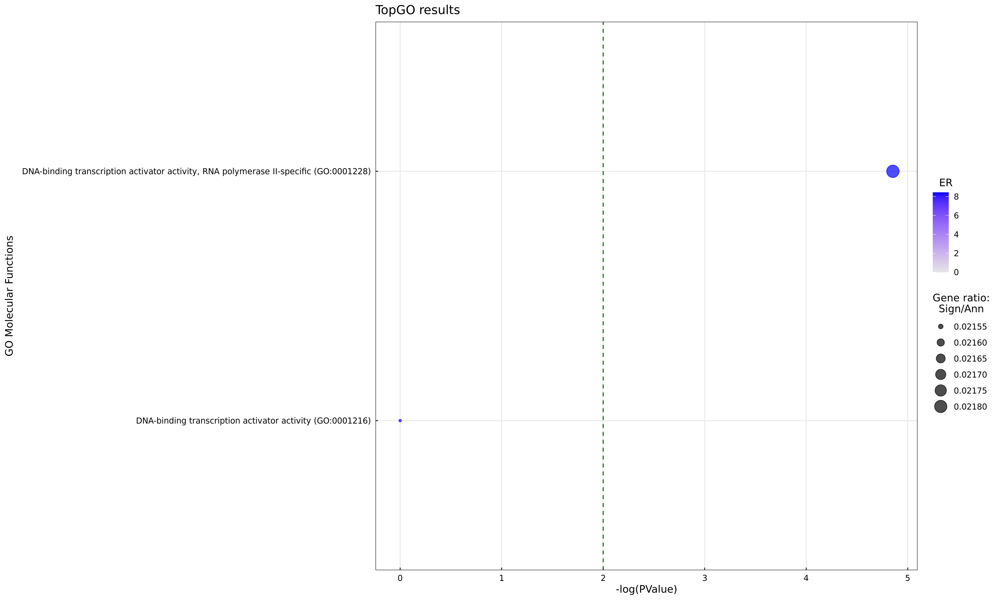

In [122]:
%%R
bubbleplot(ResSel, Ont = 'MF', fillCol = 'blue')

In [123]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

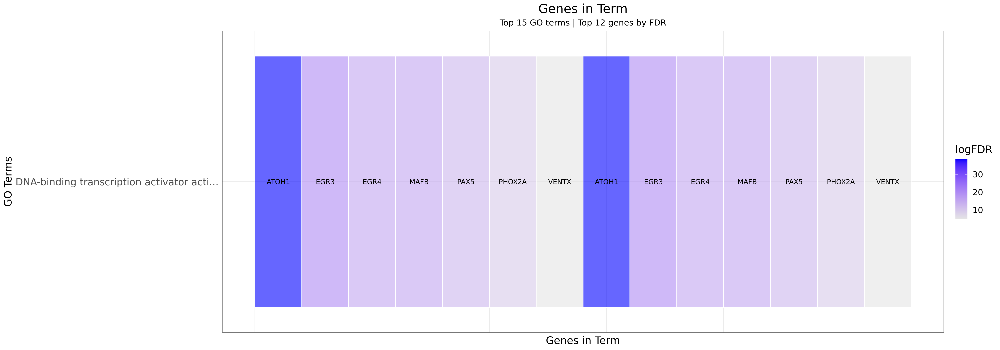

In [124]:
%%R -i deg_table_filtered
plotGenesInTerm_v3(ResMFAll$ResSel, ResMFAll$GOdata, DEGs = deg_table_filtered, nterms=15, ngenes=12,
                             fillCol='blue')

In [125]:
%%R
saveGenesInTerm(ResSel, ResMFAll$GOdata, nterms = 20, path = './tables/genesInTerm_iPSC_hEGCLCs_GO_MF_upEG.csv', 
                )

In [126]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Cellular Components

In [127]:
%%R -o ResCCAll -o ResSel
ResCCAll <- topGOResults_new(Genes=allGenes_v, GO2genes=ann_org_CC, ontology='CC', 
                         desc=NULL, nodeSize=15, algorithm='weight01', statistic='fisher', 
                         EnTh=params$GoEnTh, PvalTh=params$GoPvalTh, minTerms=15, geneTh=4,
                         saveRes=FALSE, outDir=paste0(OutputFolder), fileName='CCAll', maxAnn = 500)

ResSel <- ResCCAll$ResSel

In [128]:
results_table_py = ro.conversion.rpy2py(ResSel)
results_table_py['Statistics'] = results_table_py['Statistics'].astype('float64')
len(results_table_py)

0

In [129]:
results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Statistics)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [130]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_downregulated_hEGCLCs_vs_hiPSC_CC.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_downregulated..., filename='GO_downregulated_hEGCLCs_..., label='Download GO_downregulated...)
    [1] Tabulator(page_size=10, pagination='remote', value=Empty DataFrame
Columns: [...)

### Pathway annotation

#### Reactome

In [131]:
curated = msigdb[msigdb['collection'].isin(['reactome_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 500].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [132]:
rank = pd.DataFrame(deg_table_filtered.logFC)
rank = rank[rank.logFC < 0]

rank_copy = rank.copy()
rank_copy['pval'] = deg_table_filtered.loc[rank.index].FDR

In [133]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)

No significant term was found


In [134]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_down_hEGCLCs_vs_hiPSC_reactome.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_down_hEGCLCs_..., filename='GO_down_hEGCLCs_vs_hiPSC_..., label='Download GO_down_hEGCLCs_...)
    [1] Tabulator(page_size=10, pagination='remote', value=Empty DataFrame
Columns: [...)

#### KEGG

In [135]:
curated = msigdb[msigdb['collection'].isin(['kegg_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 500].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [136]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)
results_table_py

No significant term was found


""


In [137]:
#results_table_py = getAnnGenes(results = results_table_py, GO2gene = GO2gene['kegg_pathways'], DEGs = rank_copy)
#intTable(results_table_py, folder = tables_folder , fileName = 'GO_down_hEGCLCs_vs_hiPSC_kegg.xlsx', save = True)

In [138]:
#results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)
#_, df = plotGenesInTerm(results_table_py, GO2gene['kegg_pathways'], rank_copy, n_top_terms = 10, n_top_genes = 15, cmap = cmap_down)

In [139]:
#intTable(df, folder = tables_folder , fileName = 'genesInTerm_hiPSC_hEGCLCs_kegg_downhEGCLC.csv.xlsx', save = True)

#### Wikipathway

In [140]:
curated = msigdb[msigdb['collection'].isin(['wikipathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 500].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [141]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)
#results_table_py = getAnnGenes(results = results_table_py, GO2gene = GO2gene, DEGs = rank_copy)

No significant term was found


In [142]:
#intTable(results_table_py, folder = tables_folder , fileName = 'GO_down_hEGCLCs_vs_hiPSC_wikipathways.xlsx', save = True)

In [143]:
#results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)
#_, df = plotGenesInTerm(results_table_py, GO2gene, rank_copy, n_top_terms = 10, n_top_genes = 15, cmap = cmap_down)

In [144]:
#intTable(df, folder = tables_folder , fileName = 'genesInTerm_hiPSC_hEGCLCs_wikipathways_downhEGCLC.csv.xlsx', save = True)

:::

## All significant (up and down)

### Get annotations

In [145]:
%%R -i allSelected -i allGenes

allGenes_v <- c(allSelected)
#print(allGenes_v)
names(allGenes_v) <- allGenes
allGenes_v <- unlist(allGenes_v)
allGenes_v <- as.factor(allGenes_v)

geneNames <- c(allGenes)

ann_org_BP <- topGO::annFUN.org(whichOnto='BP', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_MF <- topGO::annFUN.org(whichOnto='MF', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_CC <- topGO::annFUN.org(whichOnto='CC', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

selection <- function(allScores){return (as.logical(allScores))}

::: {.panel-tabset}

### Biological Process

In [146]:
%%R -o ResBPAll -o ResSel
ResBPAll <- topGOResults_new(Genes=allGenes_v, GO2genes=ann_org_BP, ontology='BP', 
                         desc=NULL, nodeSize=15, algorithm='weight01', statistic='fisher', 
                         EnTh=params$GoEnTh, PvalTh=params$GoPvalTh, minTerms=15, geneTh=4,
                         saveRes=FALSE, outDir=paste0(OutputFolder), fileName='BPAll', maxAnn = 500)

ResSel <- ResBPAll$ResSel

In [147]:
results_table_py = ro.conversion.rpy2py(ResSel)
results_table_py['Statistics'] = results_table_py['Statistics'].astype('float64')
len(results_table_py)

15

In [148]:
results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Statistics)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [149]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_allSignificant_hEGCLCs_vs_hiPSC_BP.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_allSignifican..., filename='GO_allSignificant_hEGCLCs..., label='Download GO_allSignifican...)
    [1] Tabulator(page_size=10, pagination='remote', value=         GO.ID  ...)

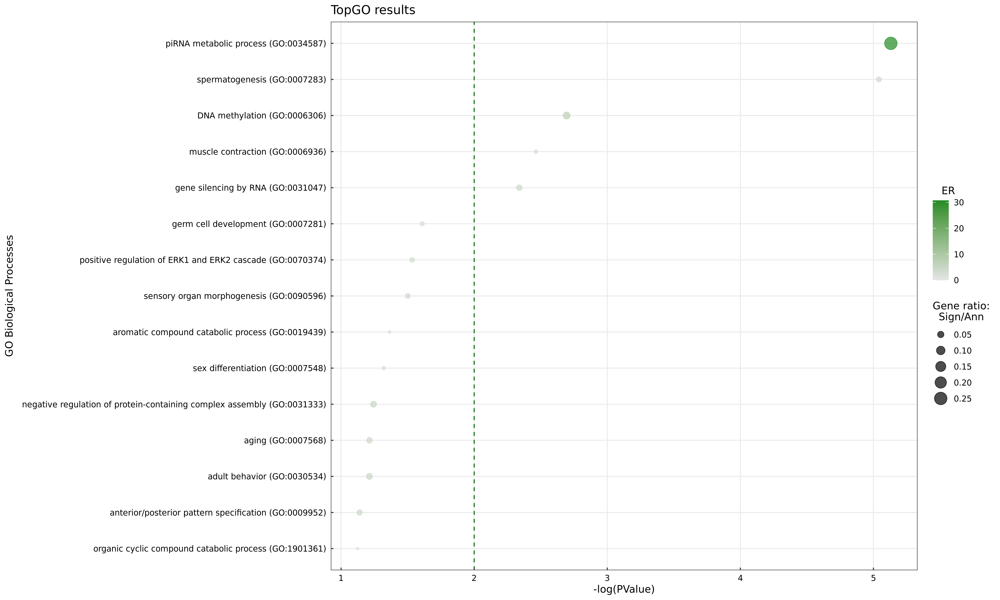

In [150]:
%%R

bubbleplot(ResSel, Ont = 'BP', fillCol = 'forestgreen')

In [151]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

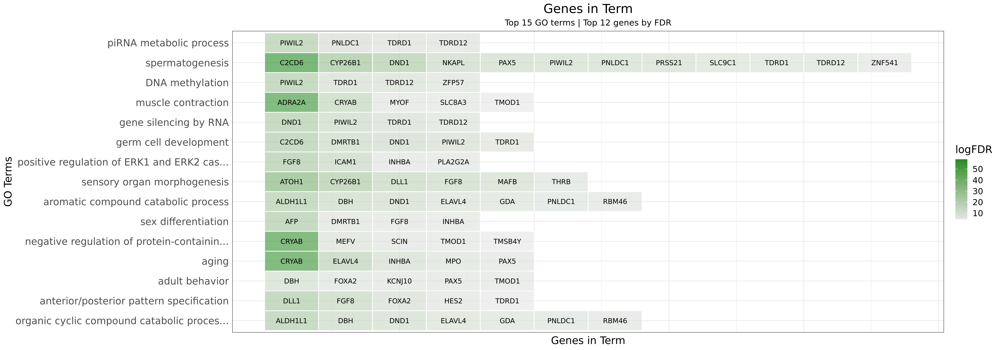

In [152]:
%%R -i deg_table_filtered
plotGenesInTerm_v3(ResBPAll$ResSel, ResBPAll$GOdata, DEGs = deg_table_filtered, nterms=15, ngenes=12,
                             fillCol='forestgreen')

In [153]:
%%R
saveGenesInTerm(ResBPAll$ResSel, ResBPAll$GOdata, nterms = 20, path = './tables/genesInTerm_iPSC_hEGCLCs_GO_BP_allSignificant.csv', SE = deg_table_filtered)

In [154]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Molecular Function

In [155]:
%%R -o ResMFAll -o ResSel
ResMFAll <- topGOResults_new(Genes=allGenes_v, GO2genes=ann_org_MF, ontology='MF', 
                         desc=NULL, nodeSize=15, algorithm='weight01', statistic='fisher', 
                         EnTh=params$GoEnTh, PvalTh=params$GoPvalTh, minTerms=15, geneTh=4,
                         saveRes=FALSE, outDir=paste0(OutputFolder), fileName='MFAll', maxAnn = 500)

ResSel <- ResMFAll$ResSel

In [156]:
results_table_py = ro.conversion.rpy2py(ResSel)
results_table_py['Statistics'] = results_table_py['Statistics'].astype('float64')
len(results_table_py)

8

In [157]:
results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Statistics)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [158]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_allSignificant_hEGCLCs_vs_hiPSC_MF.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_allSignifican..., filename='GO_allSignificant_hEGCLCs..., label='Download GO_allSignifican...)
    [1] Tabulator(page_size=10, pagination='remote', value=        GO.ID  ...)

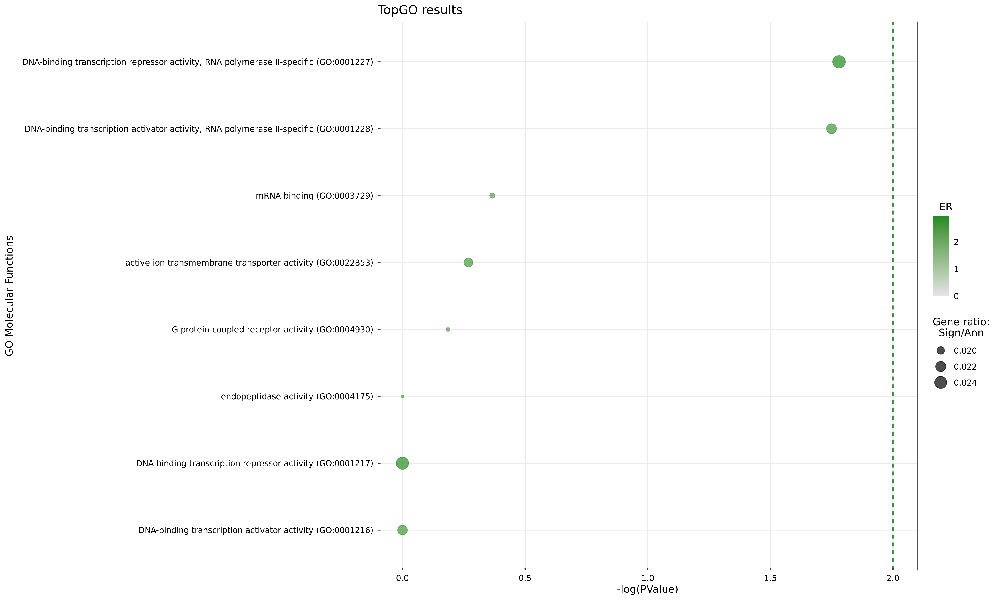

In [159]:
%%R

bubbleplot(ResSel, Ont = 'MF', fillCol = 'forestgreen')

In [160]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

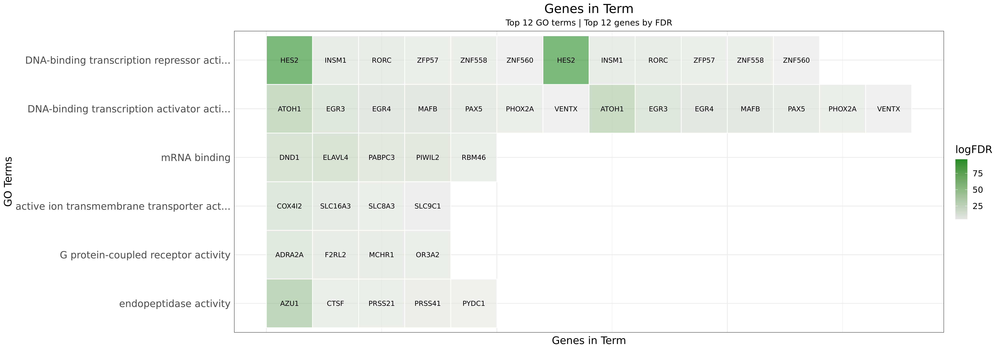

In [161]:
%%R -i deg_table_filtered
plotGenesInTerm_v3(ResSel, ResMFAll$GOdata, DEGs = deg_table_filtered, nterms=12, ngenes=12,
                             fillCol='forestgreen')

In [162]:
%%R
saveGenesInTerm(ResSel, ResMFAll$GOdata, nterms = 20, path = './tables/genesInTerm_iPSC_hEGCLCs_GO_MF_allSignificant.csv')

In [163]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Cellular Components

In [164]:
%%R -o ResCCAll -o ResSel
ResCCAll <- topGOResults_new(Genes=allGenes_v, GO2genes=ann_org_CC, ontology='CC', 
                         desc=NULL, nodeSize=15, algorithm='weight01', statistic='fisher', 
                         EnTh=params$GoEnTh, PvalTh=params$GoPvalTh, minTerms=15, geneTh=4,
                         saveRes=FALSE, outDir=paste0(OutputFolder), fileName='CCAll', maxAnn = 500)

ResSel <- ResCCAll$ResSel

In [165]:
results_table_py = ro.conversion.rpy2py(ResSel)
results_table_py['Statistics'] = results_table_py['Statistics'].astype('float64')
len(results_table_py)

10

In [166]:
results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Statistics)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [167]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_allSignificant_hEGCLCs_vs_hiPSC_BP.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_allSignifican..., filename='GO_allSignificant_hEGCLCs..., label='Download GO_allSignifican...)
    [1] Tabulator(page_size=10, pagination='remote', value=         GO.ID  ...)

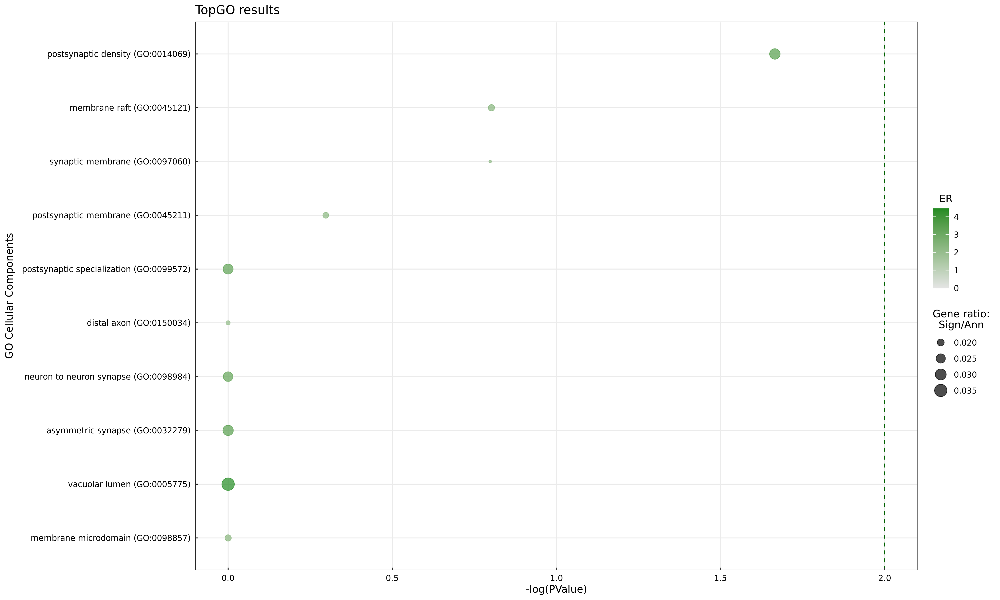

In [168]:
%%R

bubbleplot(ResSel, Ont = 'CC', fillCol = 'forestgreen')

In [169]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

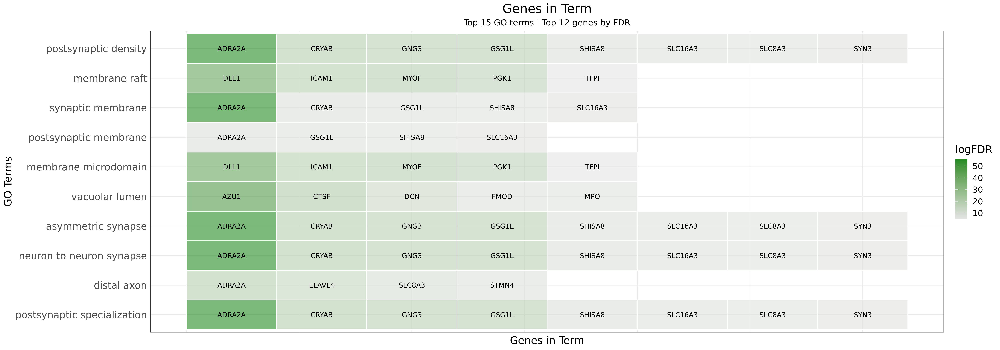

In [170]:
%%R -i deg_table_filtered
plotGenesInTerm_v3(ResCCAll$ResSel, ResCCAll$GOdata, DEGs = deg_table_filtered, nterms=15, ngenes=12,
                             fillCol='forestgreen')

In [171]:
%%R
saveGenesInTerm(ResCCAll$ResSel, ResCCAll$GOdata, nterms = 20, path = './tables/genesInTerm_iPSC_hEGCLCs_GO_CC_allSignificant.csv', SE = deg_table_filtered)

In [172]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Pathway annotation
#### Reactome

In [173]:
curated = msigdb[msigdb['collection'].isin(['reactome_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 500].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [174]:
rank = pd.DataFrame(deg_table_filtered.logFC)

In [175]:
rank_copy = rank.copy()
rank_copy['pval'] = deg_table_filtered.loc[rank.index].FDR

In [176]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)

No significant term was found


In [177]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_all_hEGCLCs_vs_hiPSC_reactome.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_all_hEGCLCs_v..., filename='GO_all_hEGCLCs_vs_hiPSC_r..., label='Download GO_all_hEGCLCs_v...)
    [1] Tabulator(page_size=10, pagination='remote', value=Empty DataFrame
Columns: [...)

In [178]:
#_, df = plotGenesInTerm(results_table_py, GO2gene['reactome_pathways'], rank_copy, n_top_terms = 10, n_top_genes = 15, cmap = cmap_all)

In [179]:
#intTable(df, folder = tables_folder , fileName = 'genesInTerm_hiPSC_hEGCLCs_Reactome_allSignificant.xlsx', save = True)

#### KEGG

In [180]:
curated = msigdb[msigdb['collection'].isin(['kegg_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 500].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [181]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)

No significant term was found


In [182]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_allSignificant_hEGCLCs_vs_hiPSC_kegg.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_allSignifican..., filename='GO_allSignificant_hEGCLCs..., label='Download GO_allSignifican...)
    [1] Tabulator(page_size=10, pagination='remote', value=Empty DataFrame
Columns: [...)

In [183]:
#_, df = plotGenesInTerm(results_table_py, GO2gene['kegg_pathways'], rank_copy, n_top_terms = 10, n_top_genes = 15, cmap = cmap_all)

In [184]:
#intTable(df, folder = tables_folder , fileName = 'genesInTerm_hiPSC_hEGCLCs_kegg_allSignificant.csv.xlsx', save = True)

#### Wikipathway

In [185]:
curated = msigdb[msigdb['collection'].isin(['wikipathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 500].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [186]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)
results_table_py = getAnnGenes(results = results_table_py, GO2gene = GO2gene, DEGs = rank_copy)

results_table_py = results_table_py[results_table_py['pvals'] < 0.05]
results_table_py = results_table_py[results_table_py['n_gene_annotated'] < 500]
results_table_py = results_table_py[results_table_py['n_gene_annotated'] > 15]
results_table_py = results_table_py[results_table_py['n_gene_significant'] > 4]

In [187]:
intTable(results_table_py, folder = tables_folder , fileName = 'GO_allSignificant_hEGCLCs_vs_hiPSC_wikipathways.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/GO_allSignifican..., filename='GO_allSignificant_hEGCLCs..., label='Download GO_allSignifican...)
    [1] Tabulator(page_size=10, pagination='remote', value=                          ...)

In [188]:
_, df = plotGenesInTerm(results_table_py, GO2gene, rank_copy, n_top_terms = 1, n_top_genes = 15, cmap = cmap_all)

In [189]:
intTable(df, folder = tables_folder , fileName = 'genesInTerm_hiPSC_hEGCLCs_wikipathways_allSignificant.csv.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/genesInTerm_hiPS..., filename='genesInTerm_hiPSC_hEGCLCs..., label='Download genesInTerm_hiPS...)
    [1] Tabulator(page_size=10, pagination='remote', value=              ...)

:::

# Save